In [1]:
from numpy.random import seed
seed(1)
from tensorflow import set_random_seed
set_random_seed(1)

/usr/local/lib/python3.5/dist-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
from neural_stylization.transfer_style import Stylizer
from neural_stylization.optimizers import SGD, L_BFGS
from neural_stylization.util.build_callback import build_callback

Using TensorFlow backend.


In [4]:
# the location of the base content for this notebook
CONTENT = 'img/content/tubingen.jpg'
CONTENT

'img/content/tubingen.jpg'

In [5]:
# the standardized dimensions for the images in this notebook
# DIMS = int(1024/2), int(768/2)

# setting to None uses the default size of the content image.
# WARNING: extremely memory intensive depending on the size
# of the content image. prepare to torture your machine
DIMS = None

DIMS

In [6]:
Stylizer()

Stylizer(
    content_layer_name='block4_conv2',
    content_weight=1.0,
    style_layer_names=['block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1', 'block5_conv1'],
    style_layer_weights=[0.2, 0.2, 0.2, 0.2, 0.2],
    style_weight=10000.0,
    total_variation_weight=0.0
)

# Vanilla Gradient Descent

## Seated Nudes

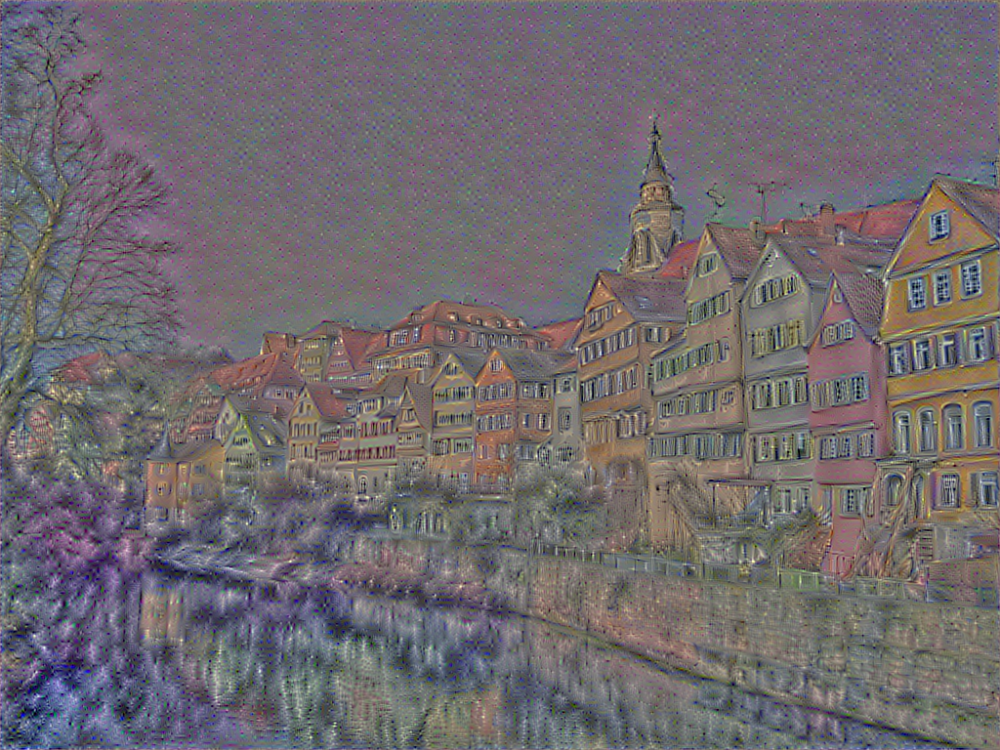

100%|██████████| 500/500 [09:12<00:00,  1.10s/it]


In [7]:
sty = Stylizer(content_weight=1, style_weight=2e3)

seated_nudes = sty(
    content_path=CONTENT,
    style_path='img/styles/seated-nude.jpg',
    optimize=SGD(learning_rate=5e-5),
    iterations=500,
    image_size=DIMS,
    callback=build_callback('build/transfer/seated-nudes/sgd')
)

seated_nudes.save('tex/img/transfer/seated-nudes.png')

## Starry Starry Night

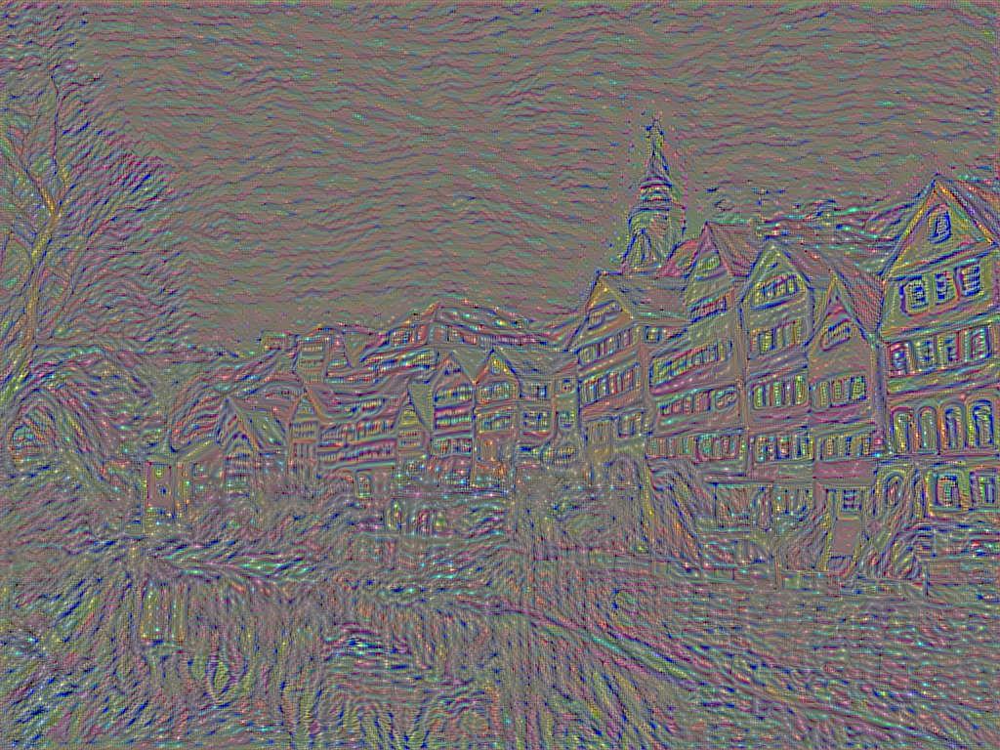

100%|██████████| 500/500 [08:54<00:00,  1.07s/it]


In [19]:
sty = Stylizer(content_weight=1, style_weight=1e4)

starry_night = sty(
    content_path=CONTENT,
    style_path='img/styles/starry_night_google.jpg',
    optimize=SGD(learning_rate=5e-6),
    iterations=500,
    image_size=DIMS,
    callback=build_callback('build/transfer/starry-night/sgd')
)

starry_night.save('tex/img/transfer/starry-starry-night.png')

## The Scream

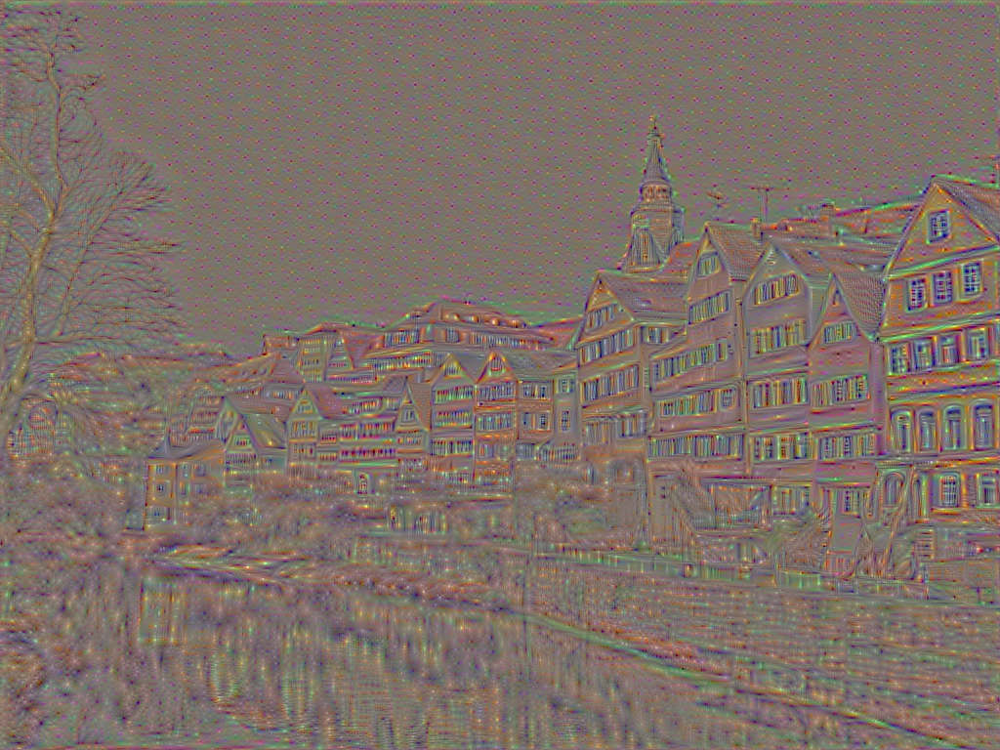

100%|██████████| 500/500 [10:38<00:00,  1.28s/it]


In [20]:
sty = Stylizer(content_weight=1, style_weight=1e3)

scream = sty(
    content_path=CONTENT,
    style_path='img/styles/the_scream.jpg',
    optimize=SGD(learning_rate=1e-5),
    iterations=500,
    image_size=DIMS,
    callback=build_callback('build/transfer/scream/sgd')
)

scream.save('tex/img/transfer/scream.png')

## Shipwreck

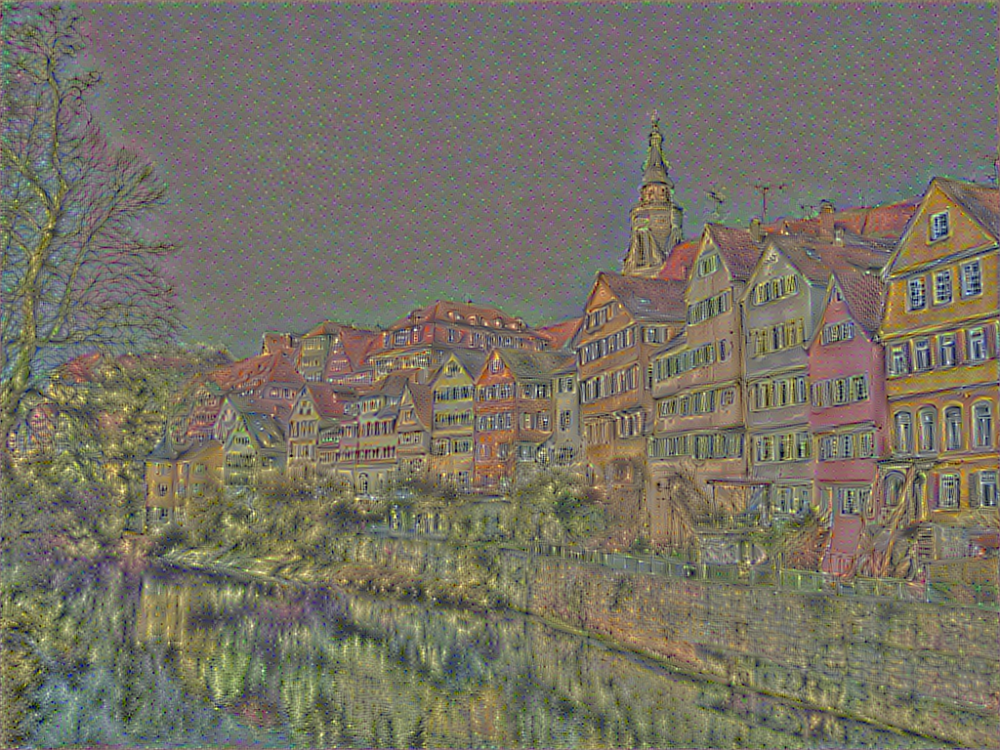

100%|██████████| 500/500 [09:12<00:00,  1.10s/it]


In [21]:
sty = Stylizer(content_weight=1, style_weight=1e3)

shipwreck = sty(
    content_path=CONTENT,
    style_path='img/styles/shipwreck.jpg',
    optimize=SGD(learning_rate=5e-5),
    iterations=500,
    image_size=DIMS,
    callback=build_callback('build/transfer/shipwreck/sgd')
)

shipwreck.save('tex/img/transfer/shipwreck.png')

## Kandinsky

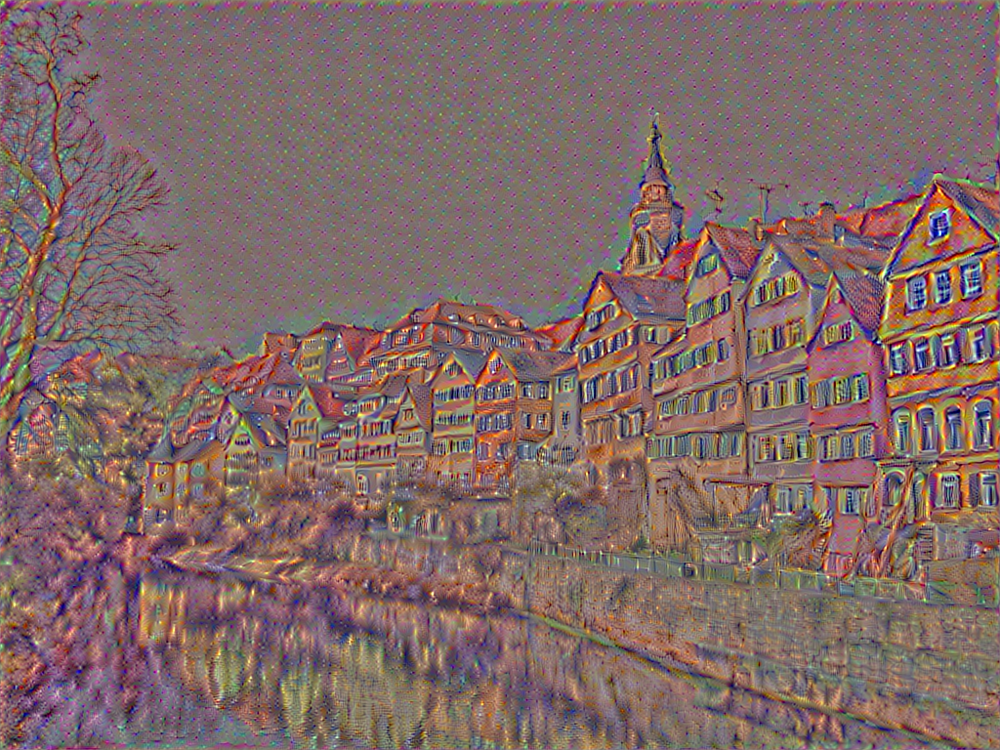

100%|██████████| 500/500 [09:16<00:00,  1.11s/it]


In [22]:
sty = Stylizer(content_weight=1, style_weight=1e3)

kandinsky = sty(
    content_path=CONTENT,
    style_path='img/styles/kandinsky.jpg',
    optimize=SGD(learning_rate=5e-5),
    iterations=500,
    image_size=DIMS,
    callback=build_callback('build/transfer/kandinsky/sgd')
)

kandinsky.save('tex/img/transfer/kandinsky.png')

## Monet

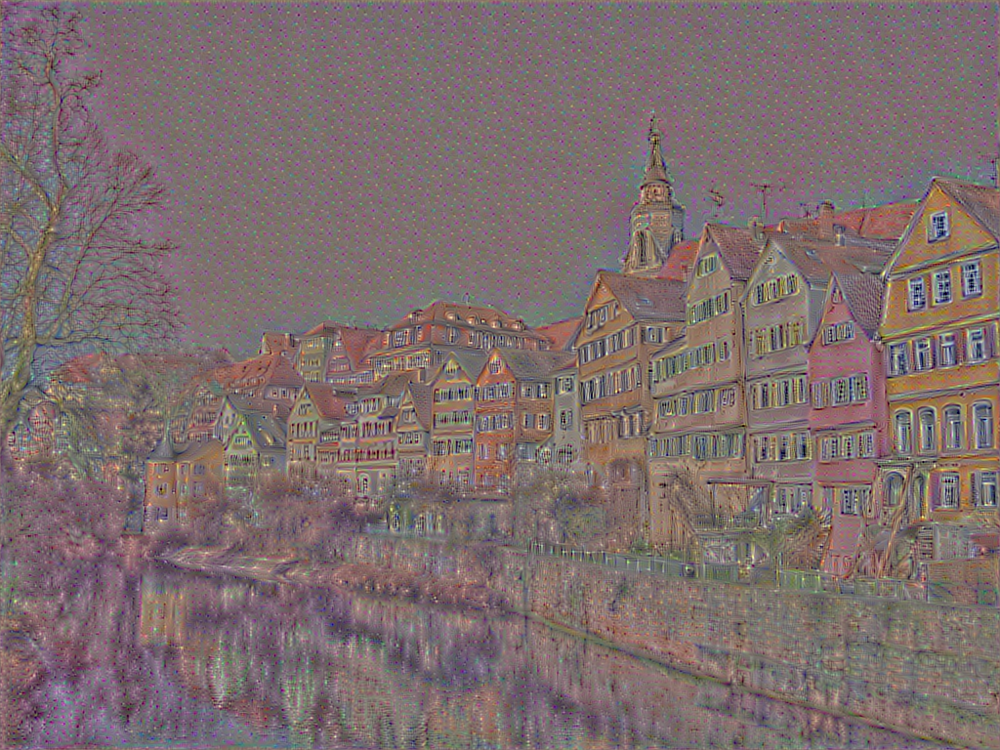

100%|██████████| 500/500 [09:23<00:00,  1.13s/it]


In [23]:
sty = Stylizer(content_weight=1, style_weight=1e3)

monet = sty(
    content_path=CONTENT,
    style_path='img/styles/monet.jpg',
    optimize=SGD(learning_rate=5e-5),
    iterations=500,
    image_size=DIMS,
    callback=build_callback('build/transfer/monet/sgd')
)

monet.save('tex/img/transfer/monet.png')

# L-BFGS Optimization

The optimizer used by Gatys et al. (and the corresponding hyperparameters as well)

## Seated Nudes

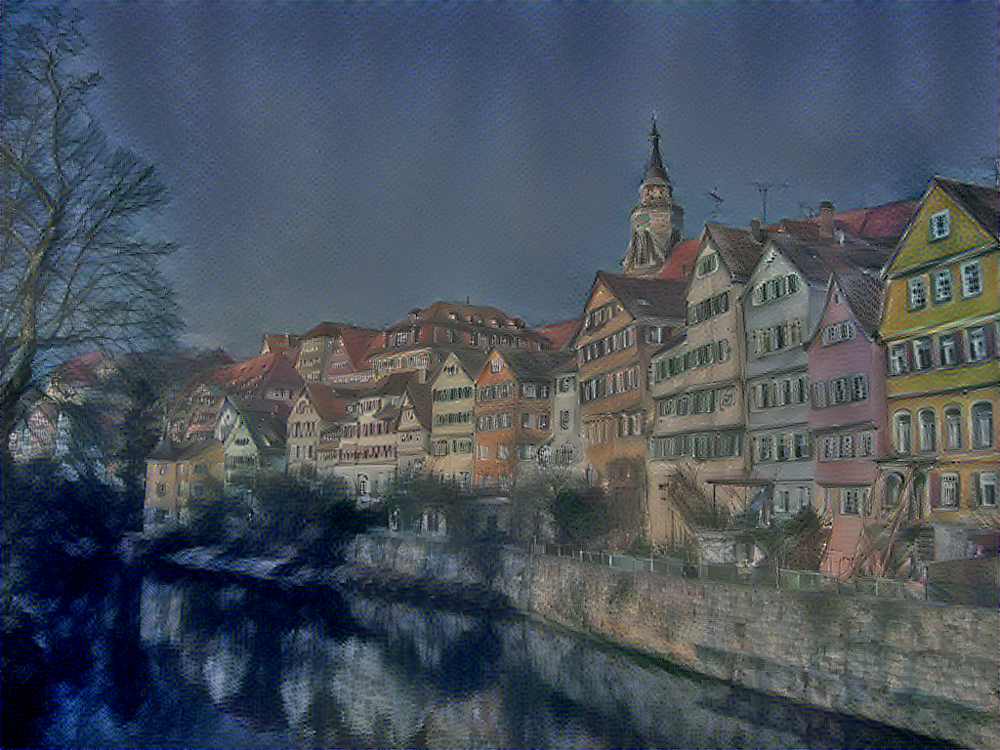

100%|██████████| 25/25 [07:55<00:00, 19.02s/it]


In [10]:
sty = Stylizer(content_weight=1, style_weight=1e4)

seated_nudes = sty(
    content_path=CONTENT,
    style_path='img/styles/seated-nude.jpg',
    optimize=L_BFGS(max_evaluations=20),
    iterations=25,
    image_size=DIMS,
    callback=build_callback('build/transfer/seated-nudes/lbfgs')
)

seated_nudes.save('tex/img/transfer/seated-nudes.png')

## Starry Starry Night

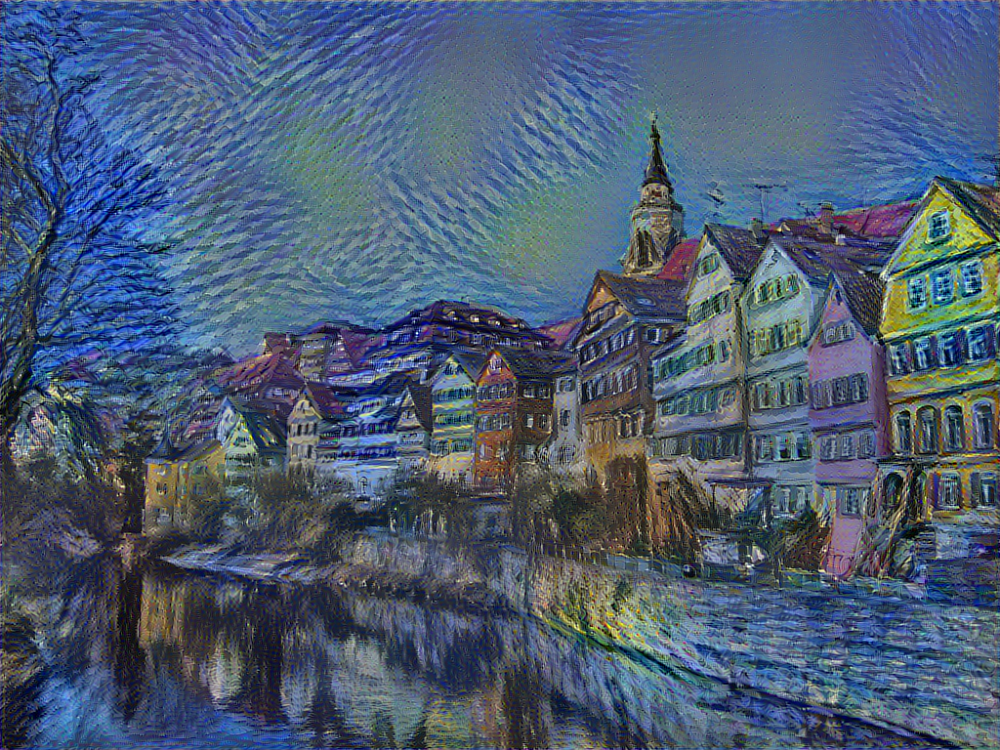

100%|██████████| 30/30 [09:23<00:00, 18.77s/it]


In [9]:
sty = Stylizer(content_weight=1, style_weight=2e4)

starry_night = sty(
    content_path=CONTENT,
    style_path='img/styles/starry_night_google.jpg',
    optimize=L_BFGS(max_evaluations=20),
    iterations=30,
    image_size=DIMS,
    callback=build_callback('build/transfer/starry-night/lbfgs')
)

starry_night.save('tex/img/transfer/starry-starry-night.png')

## The Scream

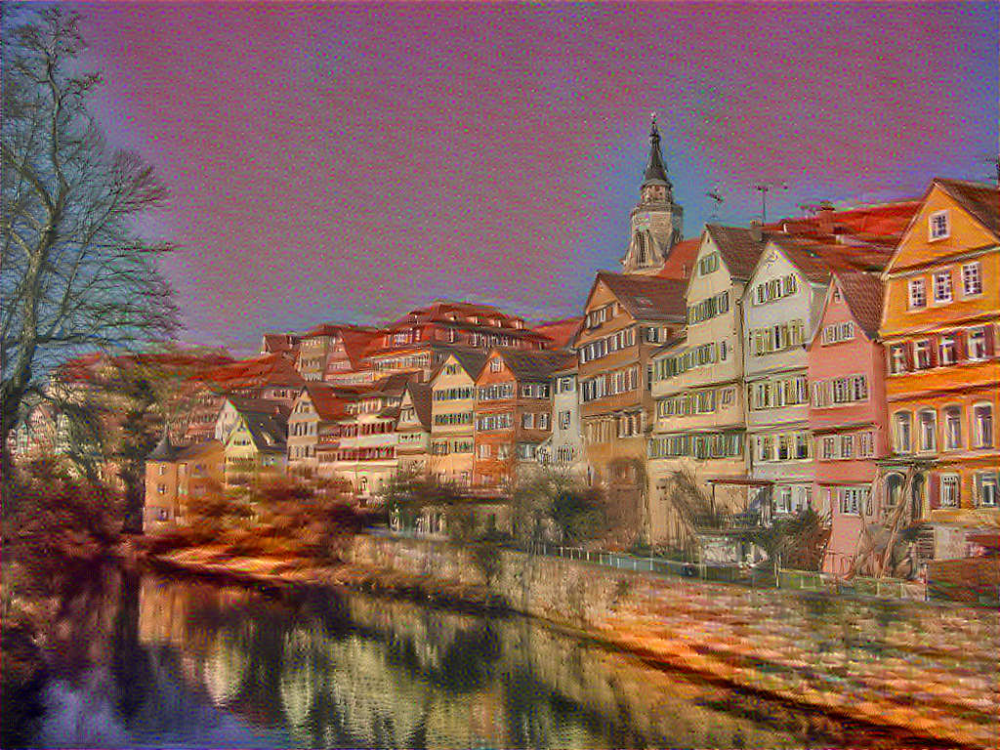

100%|██████████| 25/25 [08:07<00:00, 19.50s/it]


In [11]:
sty = Stylizer(content_weight=1, style_weight=1e3)

scream = sty(
    content_path=CONTENT,
    style_path='img/styles/the_scream.jpg',
    optimize=L_BFGS(max_evaluations=20),
    iterations=25,
    image_size=DIMS,
    callback=build_callback('build/transfer/scream/lbfgs')
)

scream.save('tex/img/transfer/scream.png')

## Shipwreck

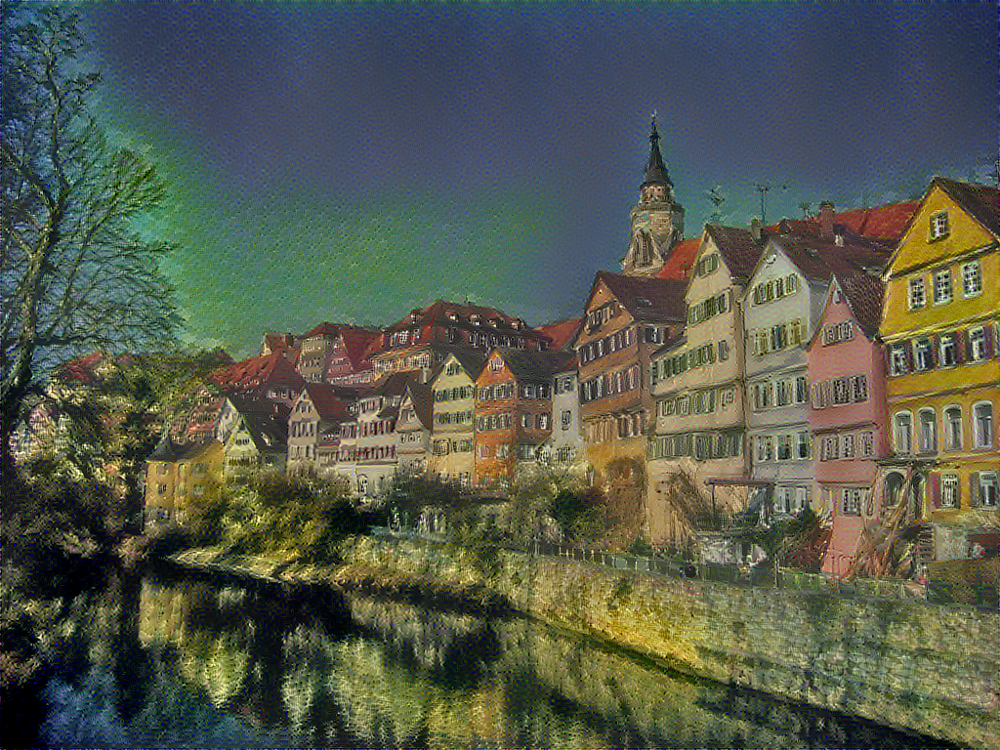

100%|██████████| 25/25 [07:54<00:00, 18.98s/it]


In [12]:
sty = Stylizer(content_weight=1, style_weight=5e3)

shipwreck = sty(
    content_path=CONTENT,
    style_path='img/styles/shipwreck.jpg',
    optimize=L_BFGS(max_evaluations=20),
    iterations=25,
    image_size=DIMS,
    callback=build_callback('build/transfer/shipwreck/lbfgs')
)

shipwreck.save('tex/img/transfer/shipwreck.png')

## Kandinsky

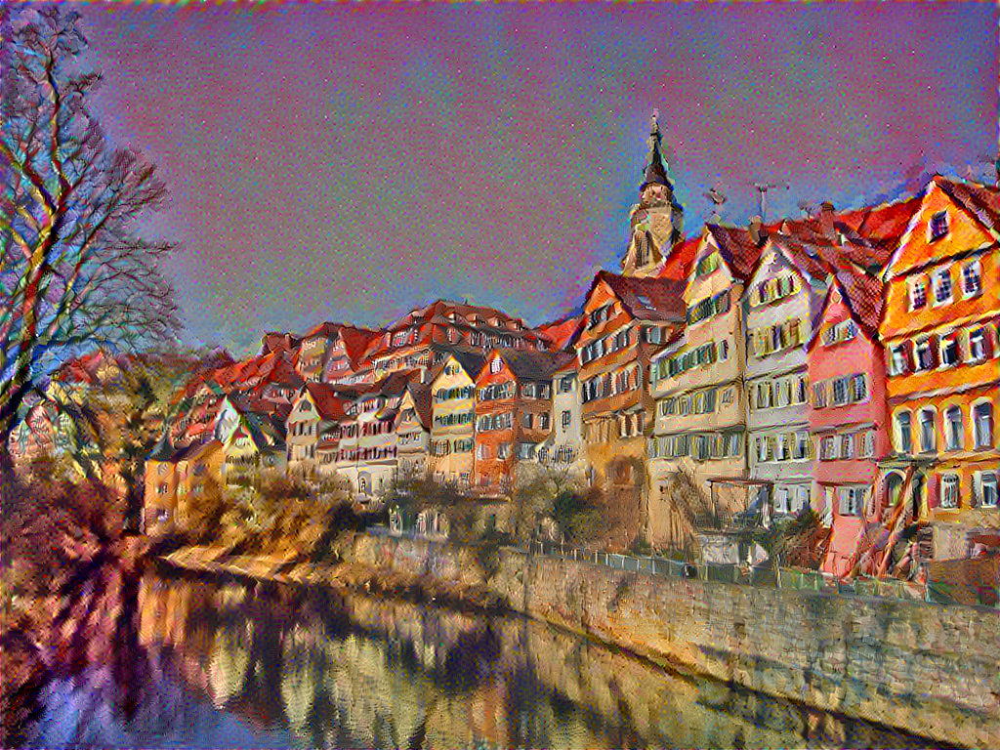

100%|██████████| 25/25 [07:39<00:00, 18.38s/it]


In [13]:
sty = Stylizer(content_weight=1, style_weight=2e3)

kandinsky = sty(
    content_path=CONTENT,
    style_path='img/styles/kandinsky.jpg',
    optimize=L_BFGS(max_evaluations=20),
    iterations=25,
    image_size=DIMS,
    callback=build_callback('build/transfer/kandinsky/lbfgs')
)

kandinsky.save('tex/img/transfer/kandinsky.png')

# Total Variation Denoising

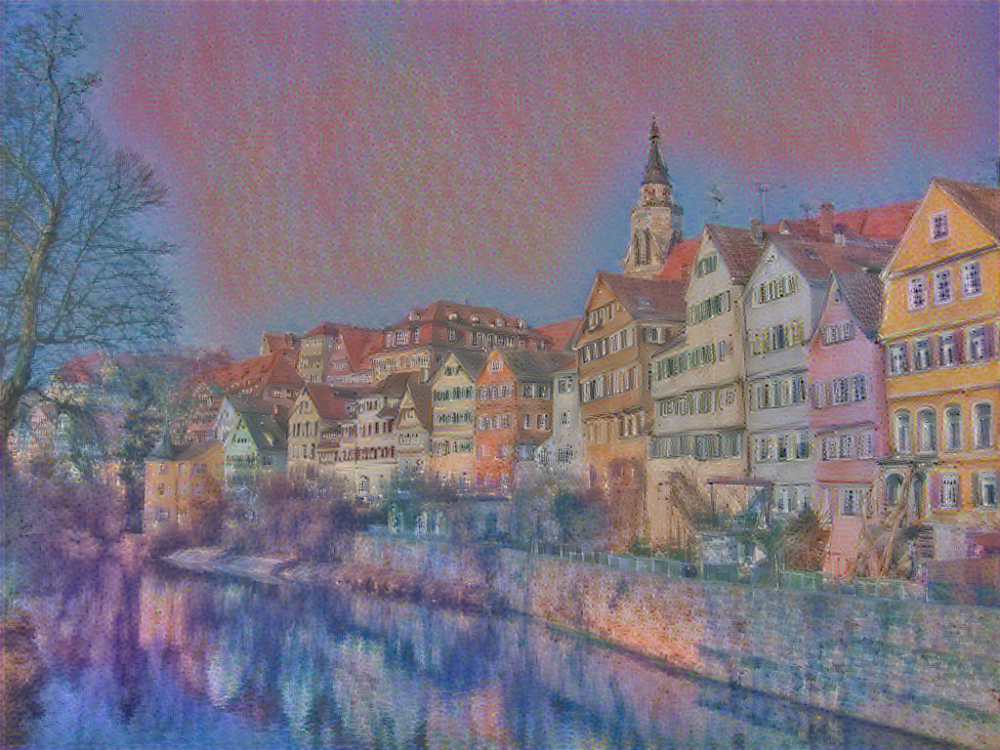

100%|██████████| 25/25 [07:53<00:00, 18.95s/it]


In [14]:
sty = Stylizer(content_weight=1, style_weight=1e4, total_variation_weight=0)

monet = sty(
    content_path=CONTENT,
    style_path='img/styles/monet.jpg',
    optimize=L_BFGS(max_evaluations=20),
    iterations=25,
    image_size=DIMS,
    callback=build_callback('build/transfer/monet/lbfgs')
)

monet.save('tex/img/transfer/monet.png')

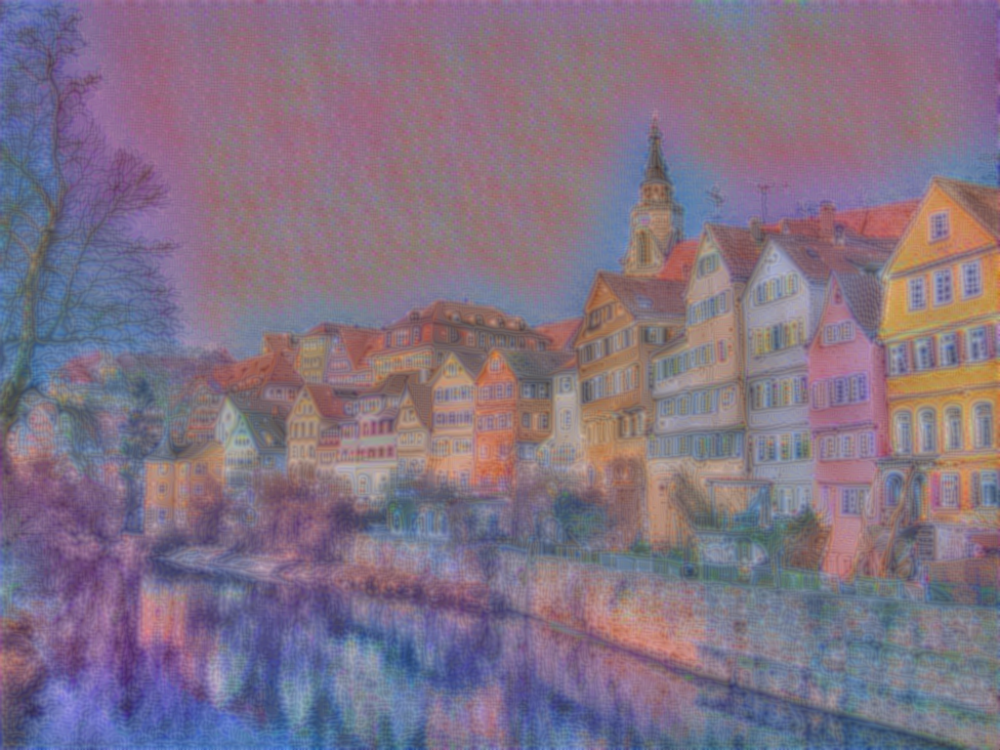

100%|██████████| 25/25 [08:03<00:00, 19.34s/it]


In [16]:
sty = Stylizer(content_weight=1, style_weight=1e4, total_variation_weight=1)

monet = sty(
    content_path=CONTENT,
    style_path='img/styles/monet.jpg',
    optimize=L_BFGS(max_evaluations=20),
    iterations=25,
    image_size=DIMS,
    callback=build_callback('build/transfer/monet/lbfgs/tv/1e0')
)

monet.save('tex/img/transfer/monet-tv-1e0.png')

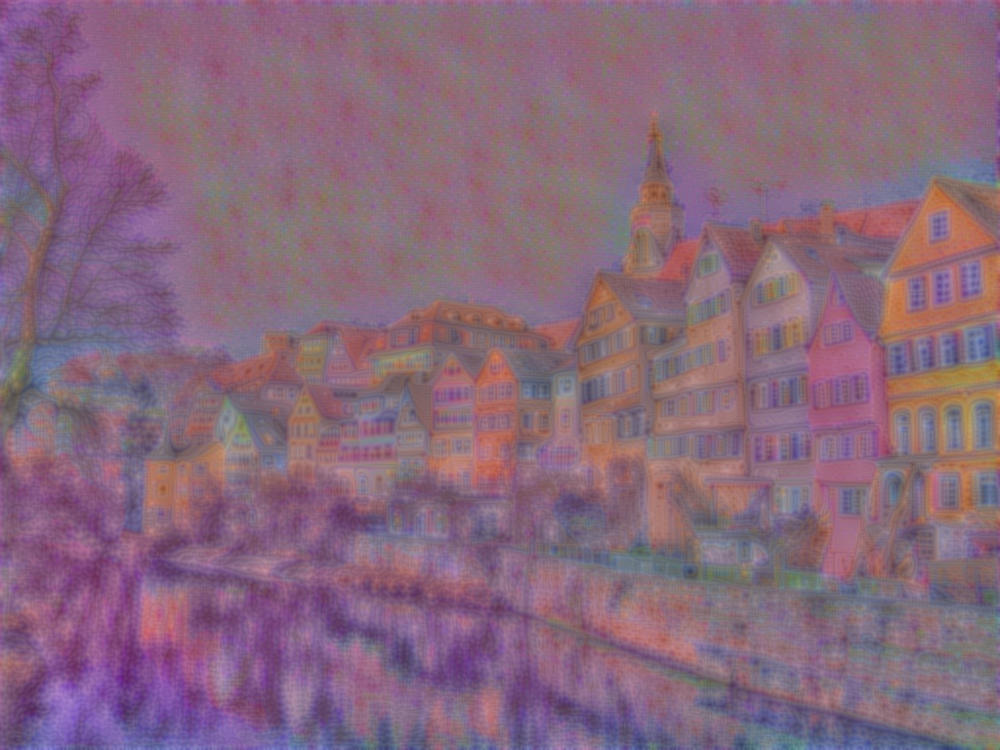

100%|██████████| 25/25 [08:08<00:00, 19.56s/it]


In [17]:
sty = Stylizer(content_weight=1, style_weight=1e4, total_variation_weight=10)

monet = sty(
    content_path=CONTENT,
    style_path='img/styles/monet.jpg',
    optimize=L_BFGS(max_evaluations=20),
    iterations=25,
    image_size=DIMS,
    callback=build_callback('build/transfer/monet/lbfgs/tv/1e1')
)

monet.save('tex/img/transfer/monet-tv-1e1.png')